In [1]:
#%conda install spectrum

.environ: No such file or directory.
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.12.0

Please update conda by running

    $ conda update -n base -c defaults conda



## Package Plan ##

  environment location: /home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc

  added / updated specs:
    - spectrum


The following NEW packages will be INSTALLED:

  spectrum           conda-forge/linux-64::spectrum-0.8.1-py310h5764c6d_0


Preparing transaction: done
Verifying transaction: done
Executing transaction: done

Note: you may need to restart the kernel to use updated packages.


In [4]:
#%conda install easydev

.environ: No such file or directory.
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.10.3
  latest version: 4.12.0

Please update conda by running

    $ conda update -n base -c defaults conda



## Package Plan ##

  environment location: /home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc

  added / updated specs:
    - easydev


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    colorama-0.4.4             |     pyh9f0ad1d_0          18 KB  conda-forge
    colorlog-6.6.0             |  py310hff52083_1          17 KB  conda-forge
    easydev-0.12.0             |     pyh6c4a22f_0          46 KB  conda-forge
    pexpect-4.8.0              |     pyh9f0ad1d_2          47 KB  conda-forge
    ptyprocess-0.7.0           |     pyhd3deb0d_0          16 KB  conda-forge
    ------------------------------------------------------------
              

In [5]:
import obspy
from obspy.clients.fdsn import Client
import matplotlib.pyplot as plt
import numpy as np
import scipy
import os
import util
from scipy.fft import fft, ifft, fftfreq, rfft
import pickle
from obspy import UTCDateTime
import scipy.signal as signal
from spectrum import *
from pylab import *

In [6]:
root = '/home/earthquakes1/homes/Rebecca/phd/data/2019_global_m3/'

In [7]:
eq_list = os.listdir(root)

client = Client("IRIS")

cat = obspy.read_events('/home/earthquakes1/homes/Rebecca/phd/data/2019_global_m3_catalog.xml')

eq_with_data = []
cat_with_data = cat.copy()
cat_with_data.clear()
for event in cat:
    eq_name = util.catEventToFileName(event)
    if os.path.isdir(root+eq_name) and os.path.isdir(root+eq_name+'/station_xml_files') and os.path.exists(root+eq_name+'/picks.pkl'):
        eq_with_data.append(eq_name)
        cat_with_data.extend([event])

In [8]:
binned_spectra = [
    [[],[],[],[]],#0-1
    [[],[],[],[]],#1-2
    [[],[],[],[]],#2-3
    [[],[],[],[]],#3-4
    [[],[],[],[]],#4-5
    [[],[],[],[]],#5-6
    [[],[],[],[]],#6-7
    [[],[],[],[]],#7-8
    [[],[],[],[]]#8-9
]

In [11]:
data

9 Trace(s) in Stream:
CX.HMBCX..HHE | 2019-01-31T19:44:44.679999Z - 2019-01-31T19:54:50.669999Z | 100.0 Hz, 60600 samples
CX.HMBCX..HHN | 2019-01-31T19:44:45.679999Z - 2019-01-31T19:54:52.669999Z | 100.0 Hz, 60700 samples
CX.HMBCX..HHZ | 2019-01-31T19:44:48.679999Z - 2019-01-31T19:54:51.669999Z | 100.0 Hz, 60300 samples
CX.PB01..HHE  | 2019-01-31T19:44:45.158393Z - 2019-01-31T19:54:55.628393Z | 100.0 Hz, 61048 samples
CX.PB01..HHN  | 2019-01-31T19:44:43.958393Z - 2019-01-31T19:54:50.028393Z | 100.0 Hz, 60608 samples
CX.PB01..HHZ  | 2019-01-31T19:44:46.698393Z - 2019-01-31T19:54:54.388393Z | 100.0 Hz, 60770 samples
CX.PB08..HHE  | 2019-01-31T19:44:46.698393Z - 2019-01-31T19:54:54.838393Z | 100.0 Hz, 60815 samples
CX.PB08..HHN  | 2019-01-31T19:44:47.448394Z - 2019-01-31T19:54:55.748394Z | 100.0 Hz, 60831 samples
CX.PB08..HHZ  | 2019-01-31T19:44:44.298393Z - 2019-01-31T19:54:50.558393Z | 100.0 Hz, 60627 samples

is it good?
is it good?
is it good?
is it good?
is it good?
is it good?
is it good?
is it good?
is it good?


(0.5, 50)

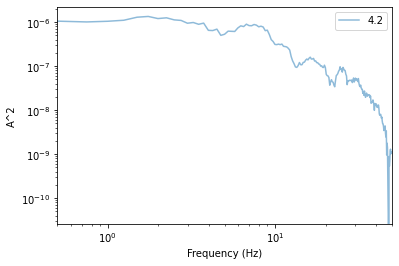

In [20]:
cmap = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple','tab:brown','tab:pink','tab:gray','tab:olive','tab:cyan']
fig, axs = plt.subplots(1,1)
failed = []
for eq_no in range(0, len(eq_with_data[0:1])):
    eq_name = eq_with_data[eq_no]
    try:
        data = obspy.read(root+eq_name+'/data/*/*')
        #data.plot()
        inv = obspy.read_inventory(root+eq_name+'/station_xml_files/*')
        data.remove_response(inv)
        with open(root+eq_name+'/picks.pkl', 'rb') as f:
            picks = pickle.load(f)
    except: 
        break
    if len(data)>0:
        successful = 0
        for tr_no in range(0, len(data)):
            try:
                sr = data[tr_no].stats.sampling_rate
                tr_name = data[tr_no].stats.network+'.'+data[tr_no].stats.station+'.'+data[tr_no].stats.location
                #print(tr_name)
                pick = UTCDateTime(picks[tr_name])
                start = pick #int((pick - data[tr_no].stats.starttime)*sr)
                end = pick + 4 # int(start + 4 * sr)
                d = data[tr_no].copy()#.filter('lowpass', freq=10)
                d.interpolate(100, 'lanczos', a = 20)
                d.filter('highpass', freq=0.25) #anything less than 0.25s (1/4s) we can't undertand or model, could be aliased.
                d.detrend()
                d.integrate()
                d.detrend()
                coda = d.trim(start, end)
                coda.detrend()
                #plt.plot(coda)
                #plt.show()
                print('is it good?')
                good = 'y'# input()
                if good.lower()[0]=='y':
                    dt = d.stats.delta

                    #creating the frequencies to plot on x axis 
                    Pfreq  = scipy.fft.rfftfreq(len(coda),dt)

                    #doing the multitaper to get the spectra 
                    N = len(coda)
                    NW=0.01*N
                    k=25
                    [tapers, eigen] = dpss(N, NW, k)
                    for eigen_no in range(0, len(eigen)):
                        if eigen[eigen_no] <= 0.5:
                            k = eigen_no
                            break
                    [tapers, eigen] = dpss(N, NW, k)

                    #print(eigen)
                    freq_complex, weights, eigenvalues=pmtm(coda, e=eigen, v=tapers, show=False)
                    freq = abs(freq_complex)
                    freq = np.mean(freq,axis =0)
                    freq_sdv = np.std(freq,axis =0)

                    dist = util.calc_hypo_dist(cat_with_data[eq_no], d, inv)
                    mag = cat_with_data[eq_no].magnitudes[0].mag
                    binned_spectra[int(np.round(mag, 0))][int(dist//50)].append([Pfreq[:-1],freq[0:N//2]])

                    #plotting the spectra in loglog
                    #print('plot')
                    if successful == 0:
                        axs.plot(Pfreq[:-1],freq[0:N//2]-min(freq[0:N//2]), alpha = 0.5, label=str(cat_with_data[eq_no].magnitudes[0].mag), color = cmap[eq_no])#tr_name + data[tr_no].stats.channel)
                    #plt.fill_between(Pfreq[:-1],(Sk+Sk_sdv)[0:N//2],(Sk-Sk_sdv)[0:N//2],alpha=0.2)
                        axs.set_xlabel('Frequency (Hz)');
                        axs.set_ylabel('A^2');
                    #plt.title(tr_name + data[tr_no].stats.channel+' coda wave Power spectra');
                    #else:
                        #axs.plot(Pfreq[:-1],freq[0:N//2]-min(freq[0:N//2]), color = cmap[eq_no], alpha = 0.5)#tr_name + data[tr_no].stats.channel)

                    Pfreq_MHZ = Pfreq
                    freq_MHZ = freq 
                    successful += 1
                else:
                    failed.append([eq_name, tr_name])
            #print(freq_MHZ.shape)
            #plt.show()
            except:
                failed.append([eq_name, tr_name])
axs.legend();
#axs.set_title('M'+str(cat_with_data[eq_no].magnitudes[0].mag) + ' ' + eq_name)
axs.set_yscale('log')
axs.set_xscale('log')
axs.set_xlim(0.5, 50)
#plt.close()


In [35]:
d

CX.HMBCX..HHE | 2019-01-31T19:44:44.679999Z - 2019-01-31T19:54:50.669999Z | 100.0 Hz, 60600 samples

In [36]:
noise

CX.HMBCX..HHE | 2019-01-29T19:50:13.489999Z - 2019-01-29T19:50:13.489999Z | 100.0 Hz, 0 samples

In [32]:
signal

CX.HMBCX..HHE | 2019-01-31T19:50:09.489999Z - 2019-01-31T19:50:13.489999Z | 100.0 Hz, 401 samples

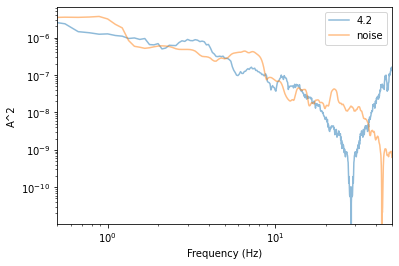

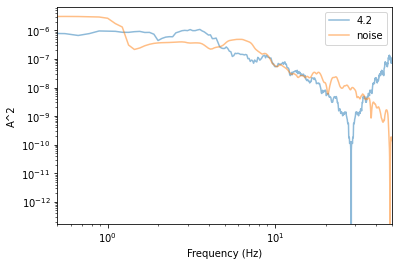

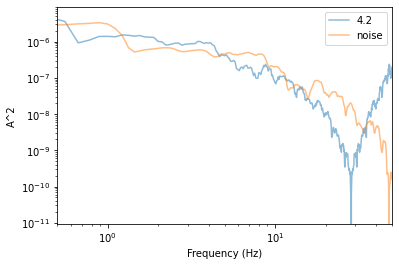

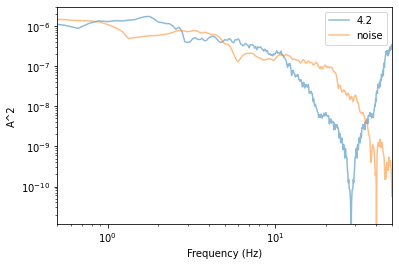

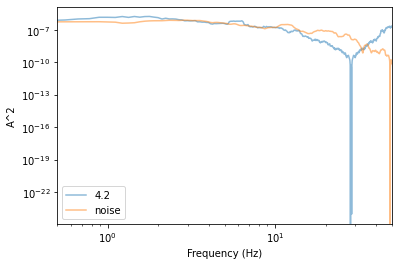

...

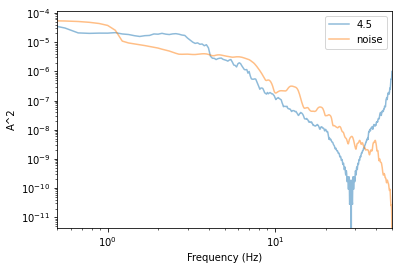

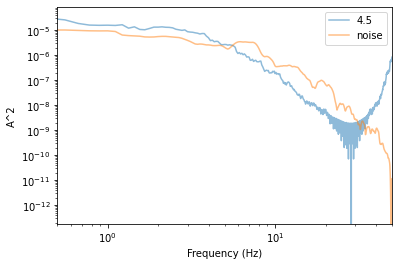

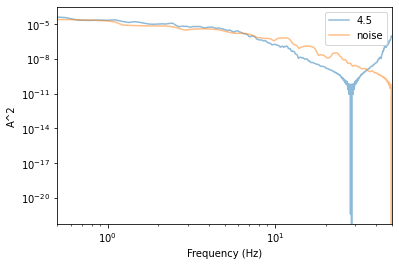

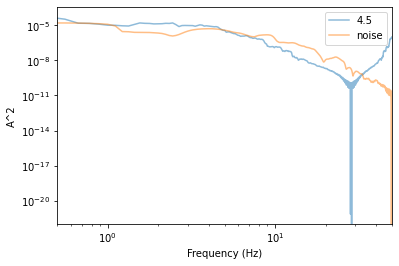

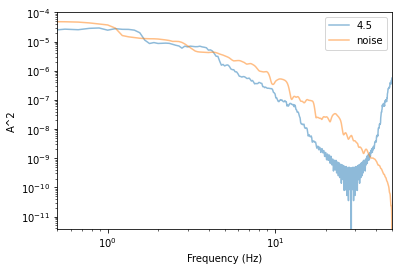

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


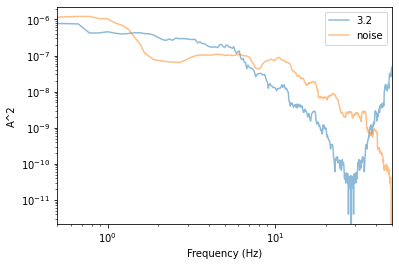

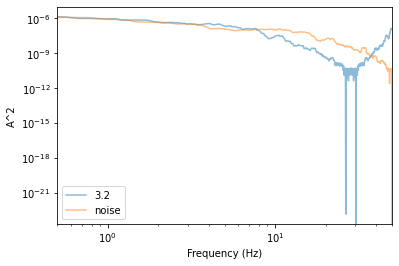

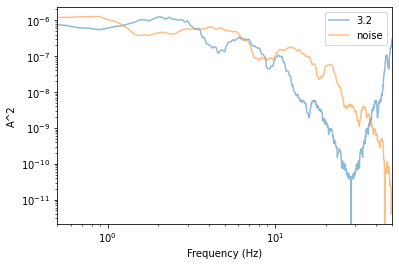

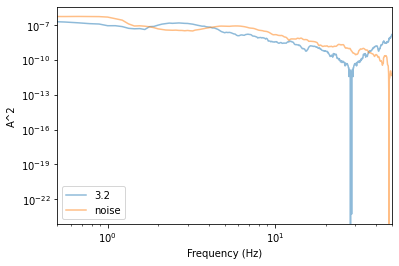

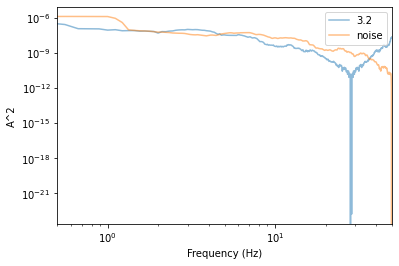

...

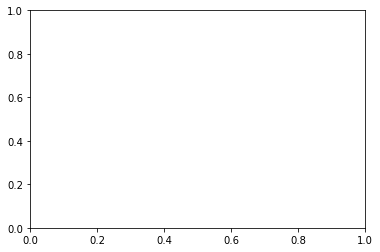

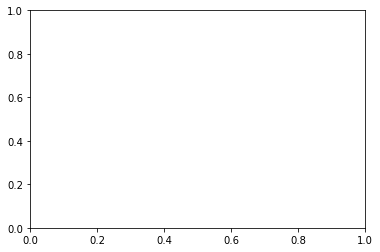

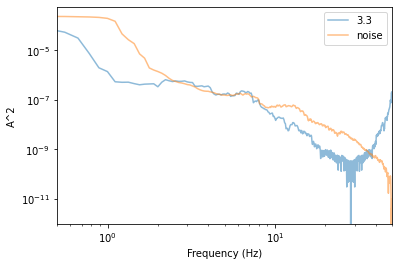

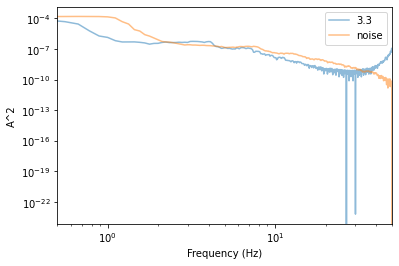

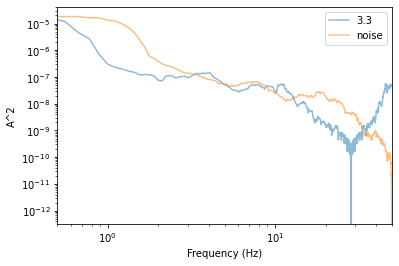

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


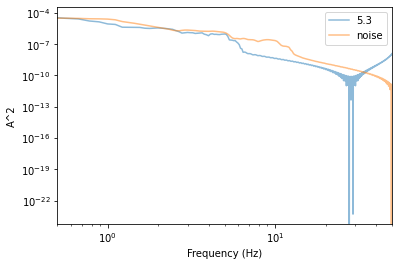

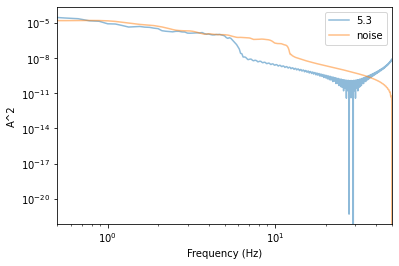

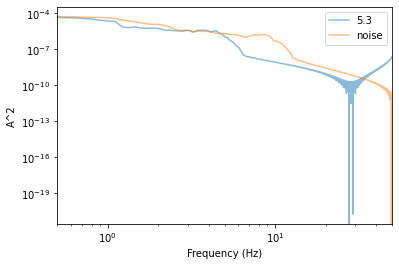

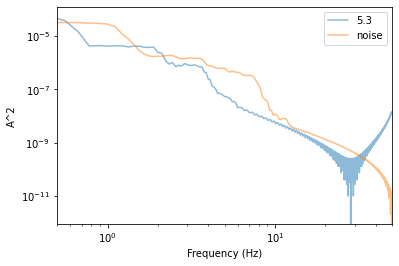

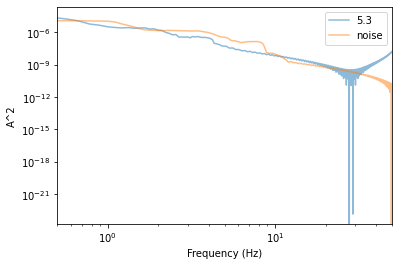

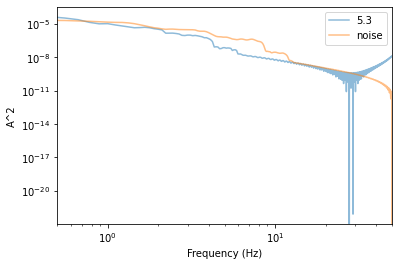

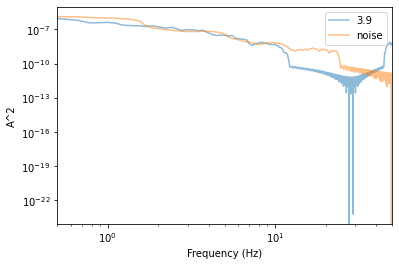

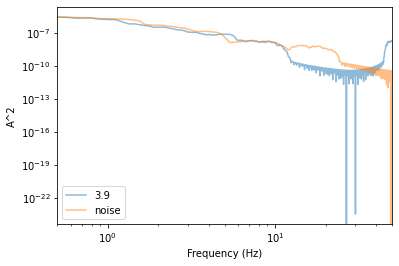

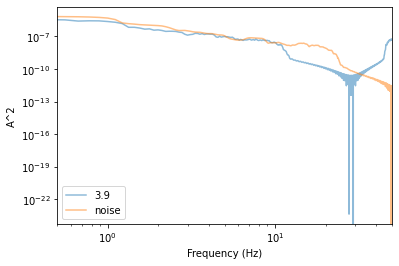

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


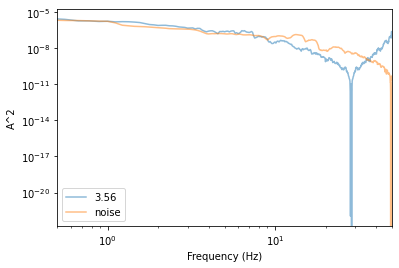

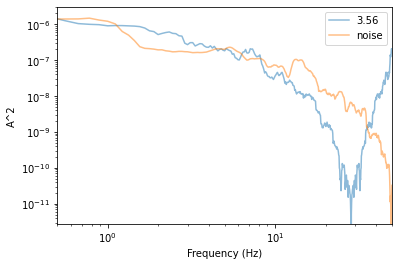

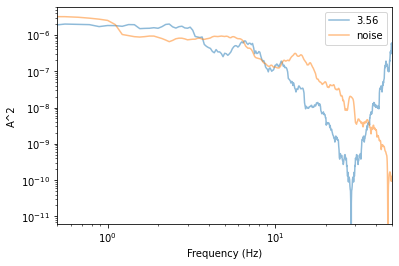

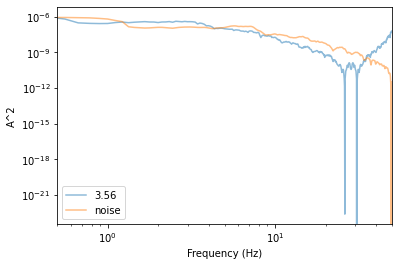

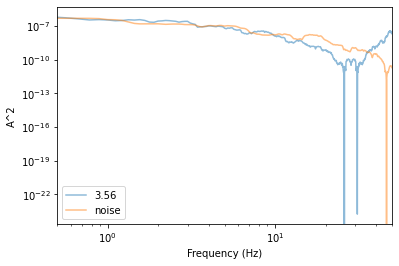

...

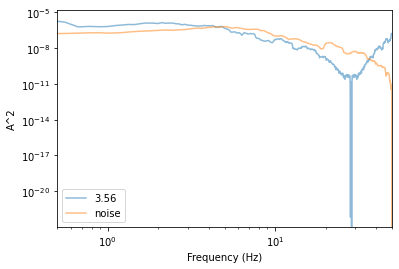

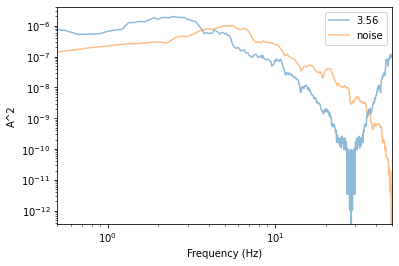

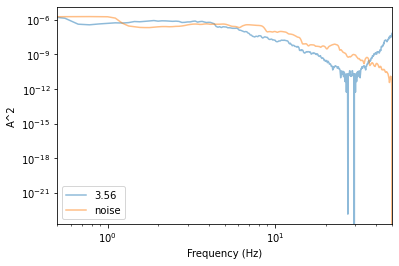

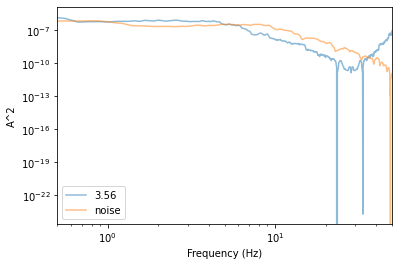

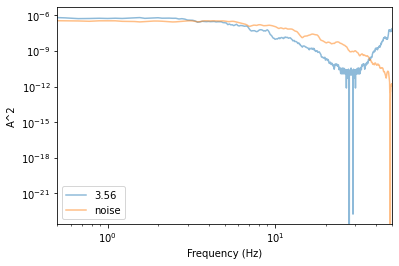

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


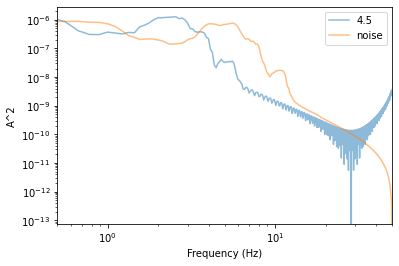

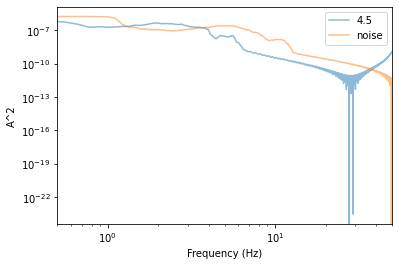

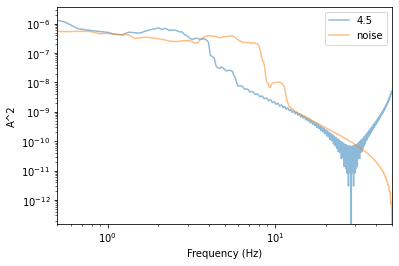

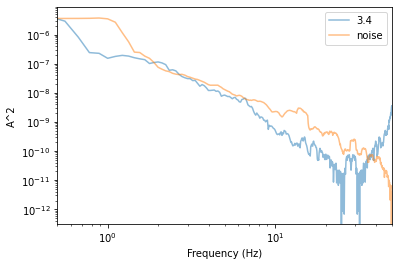

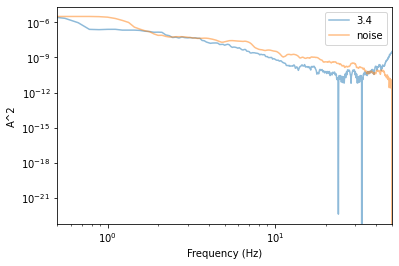

...

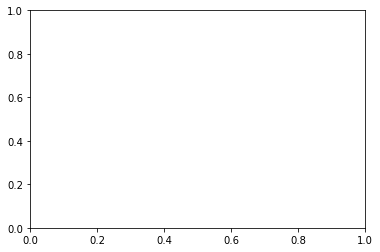

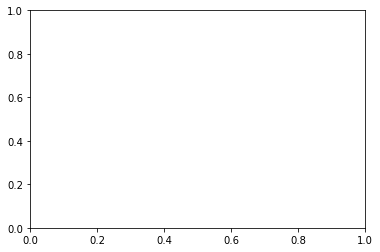

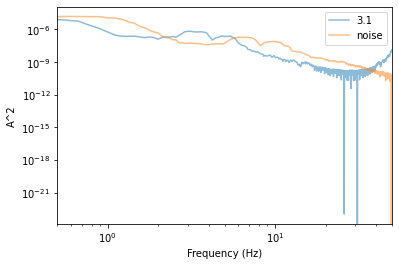

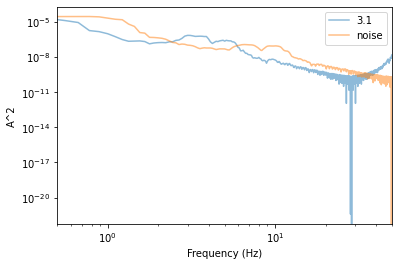

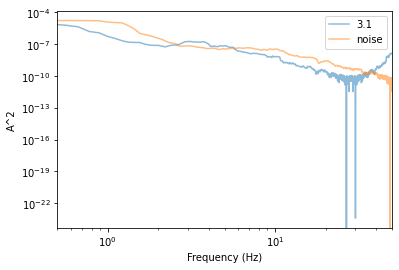

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


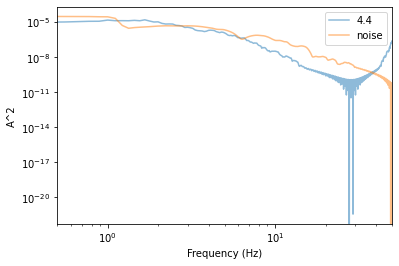

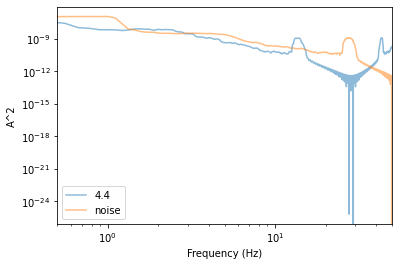

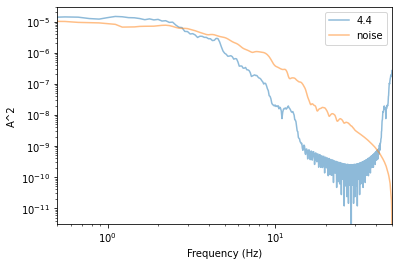

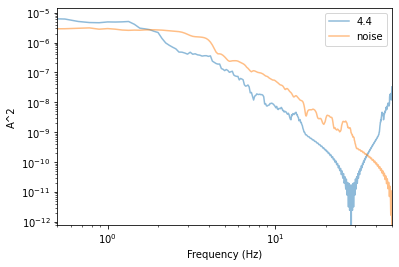

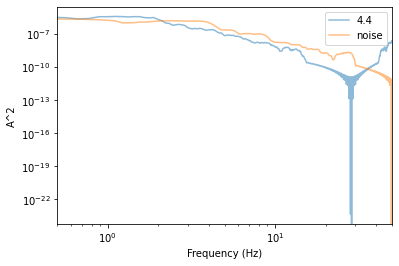

...

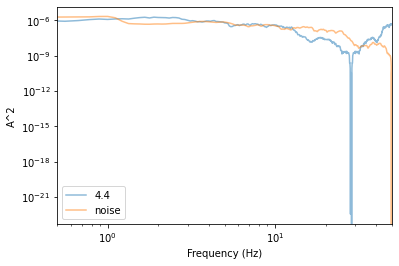

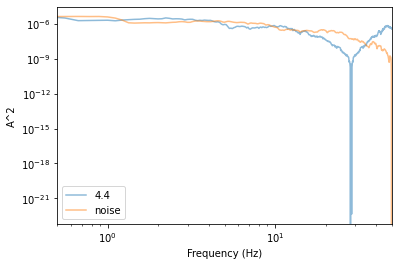

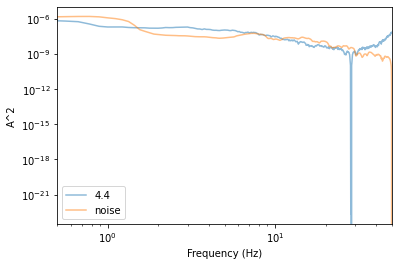

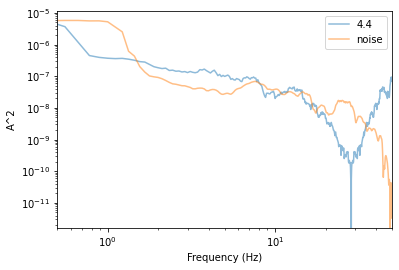

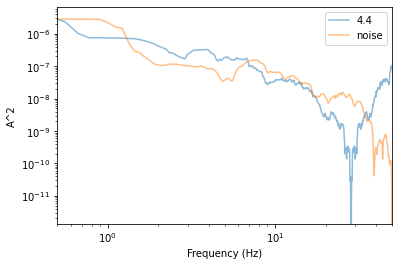

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


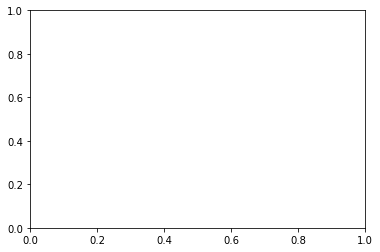

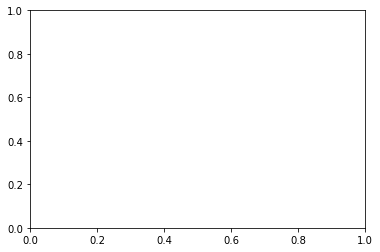

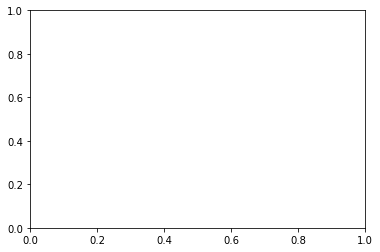

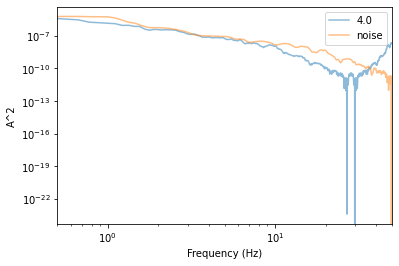

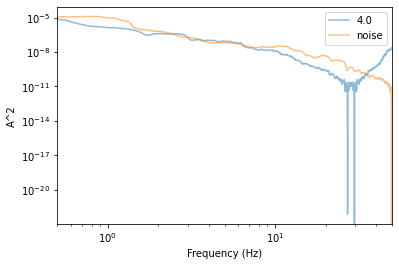

...

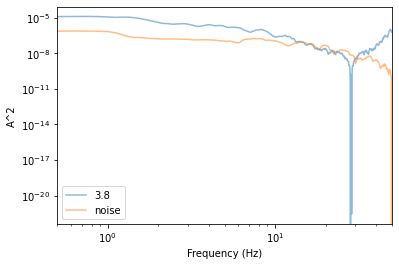

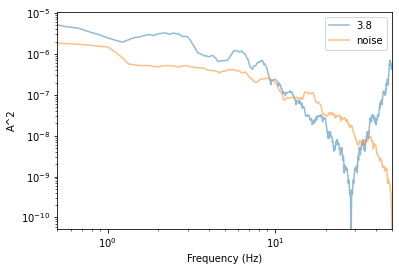

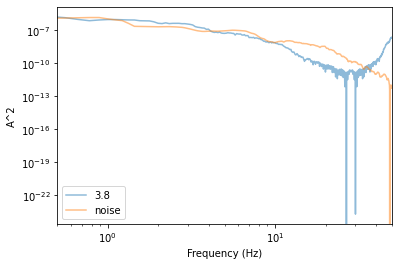

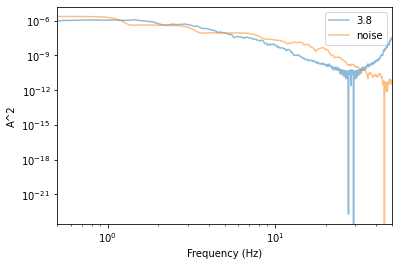

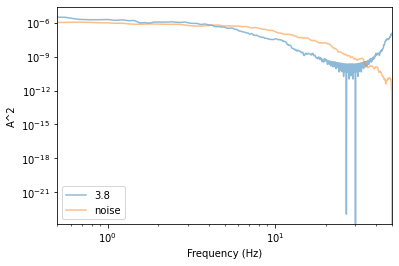

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


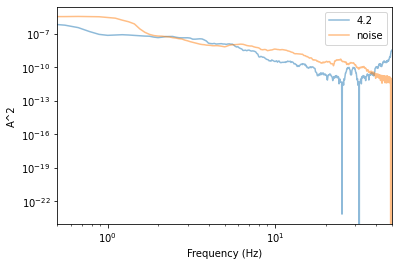

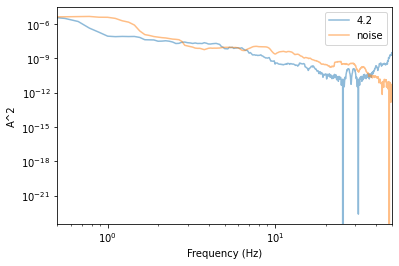

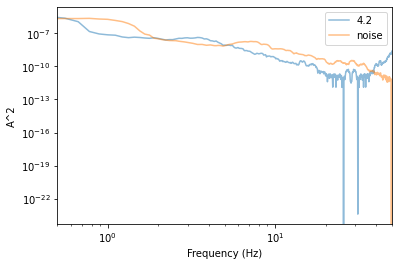

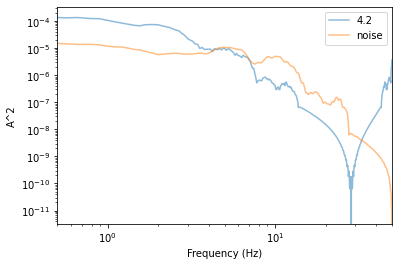

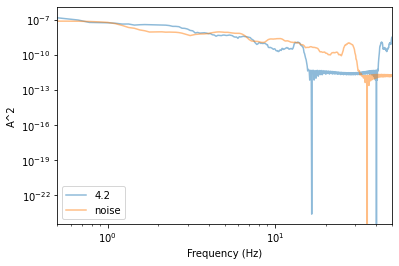

...

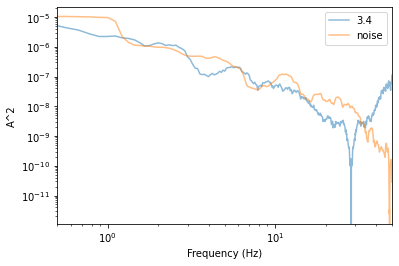

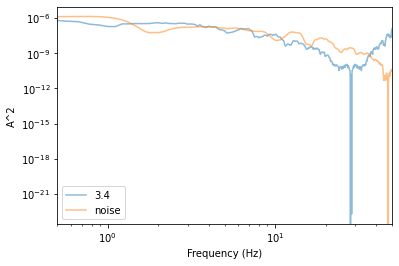

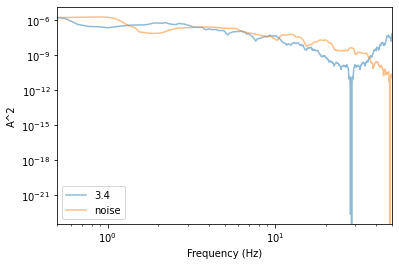

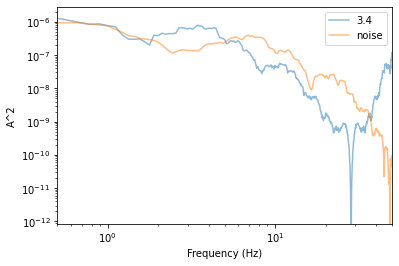

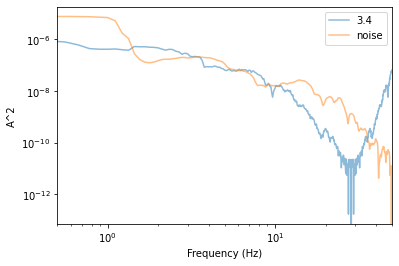

/tmp/ipykernel_1086248/1552908318.py:108: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs.set_yscale('log')


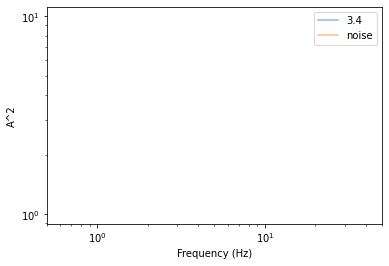

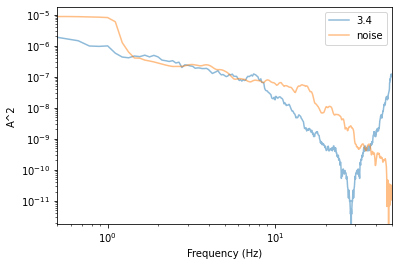

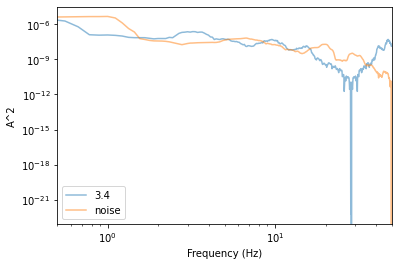

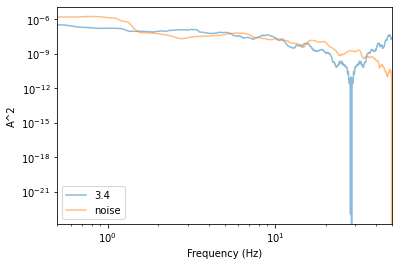

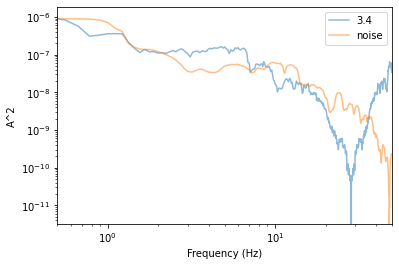

...

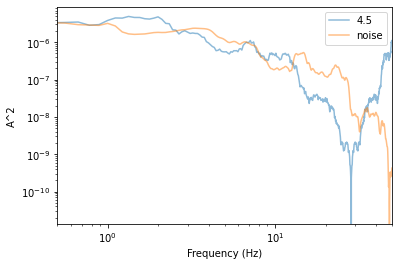

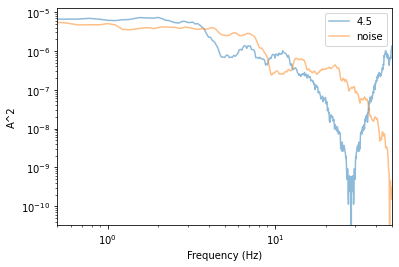

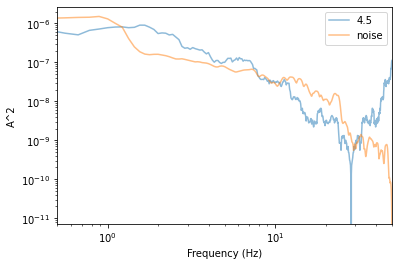

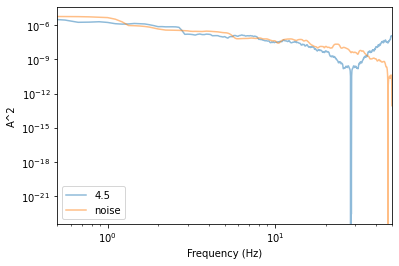

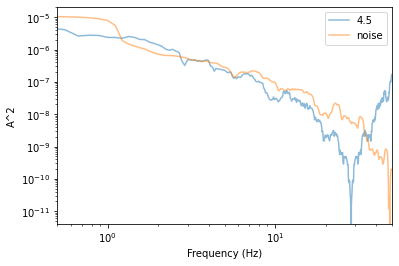

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


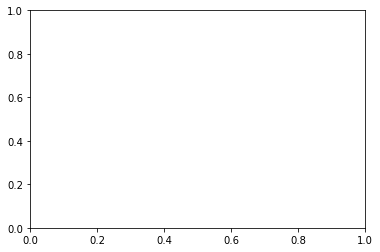

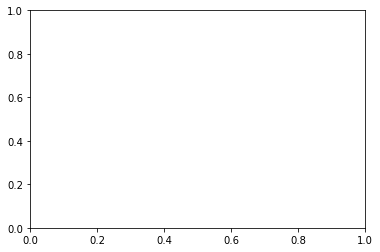

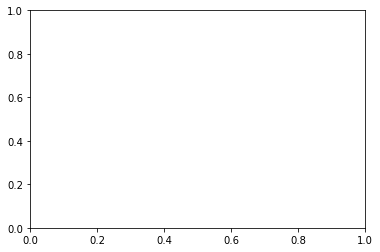

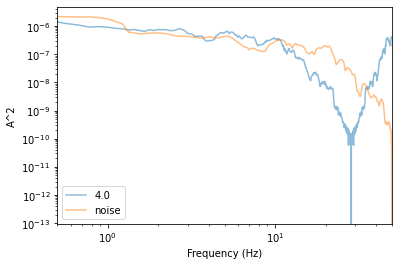

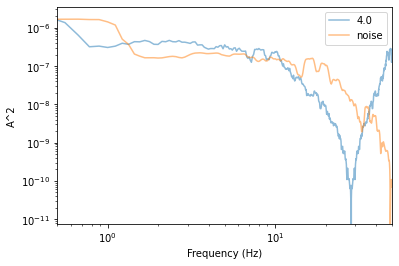

...

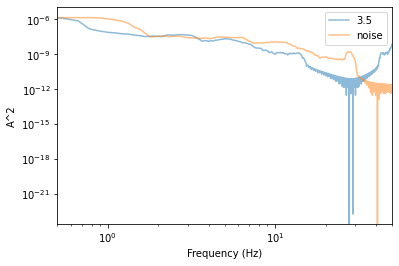

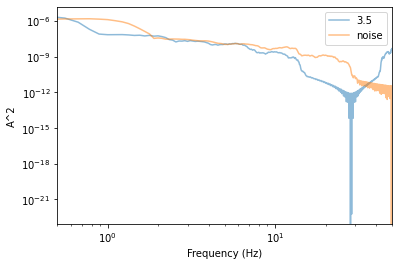

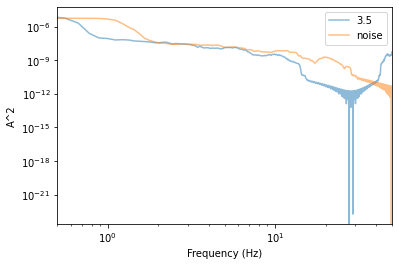

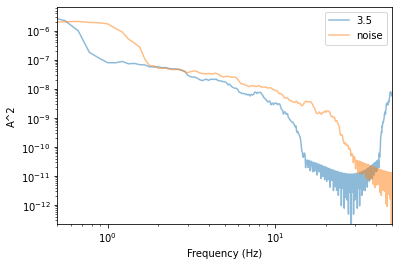

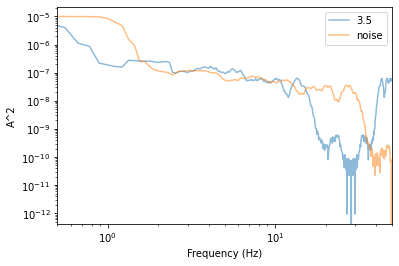

/tmp/ipykernel_1086248/1552908318.py:108: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs.set_yscale('log')


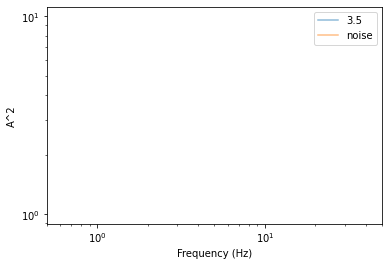

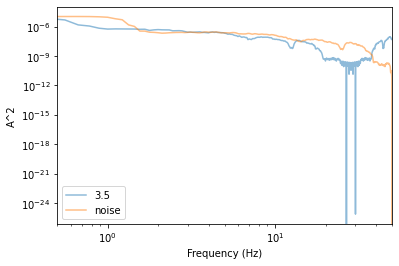

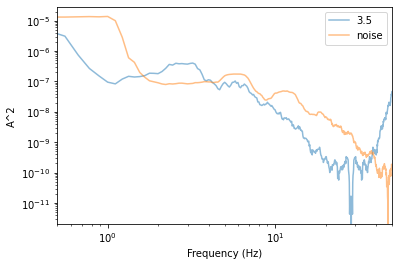

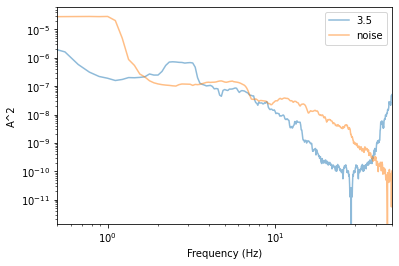

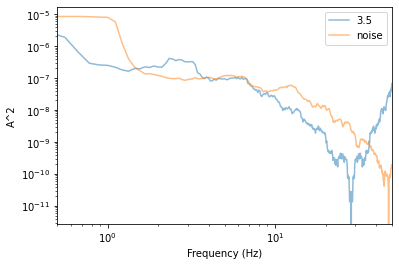

...

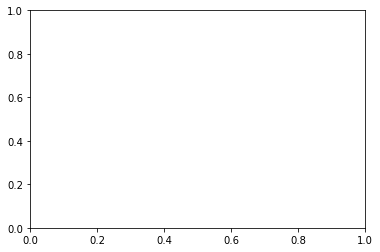

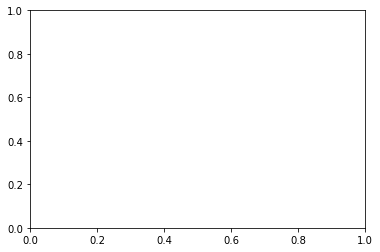

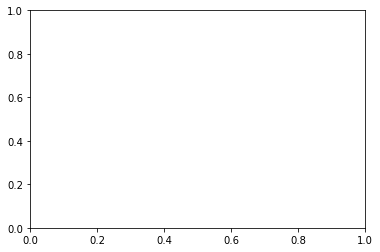

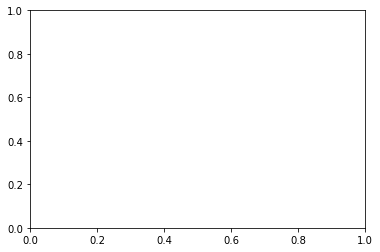

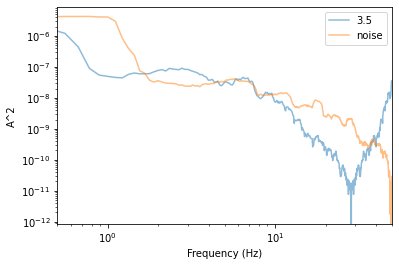

/tmp/ipykernel_1086248/1552908318.py:108: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs.set_yscale('log')


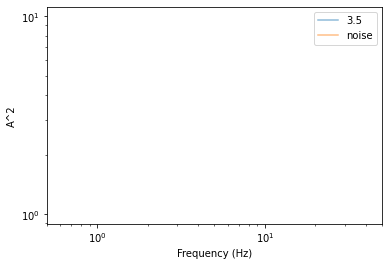

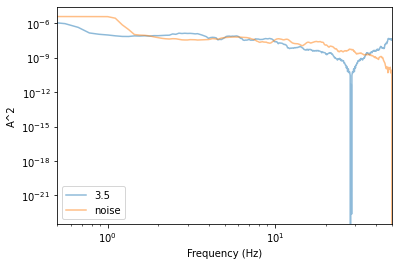

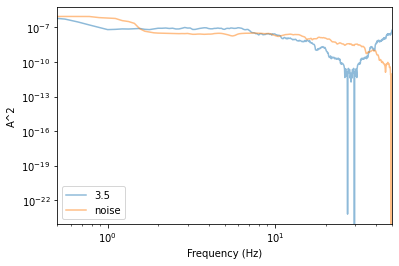

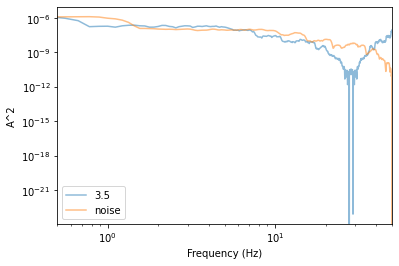

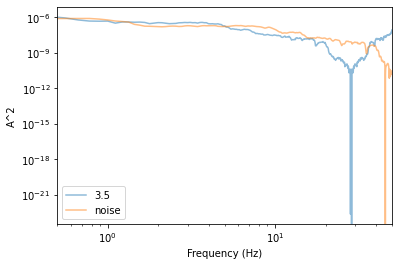

...

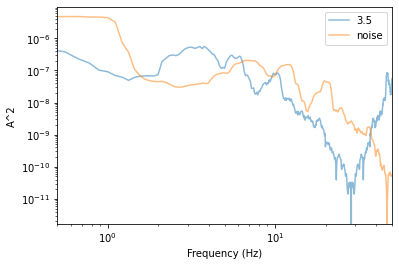

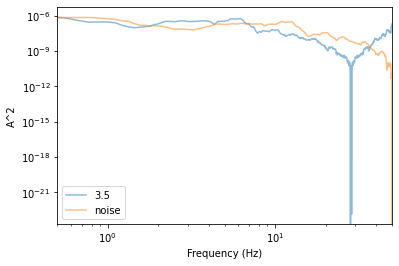

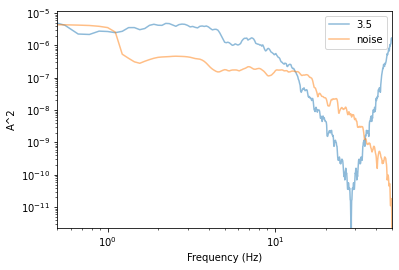

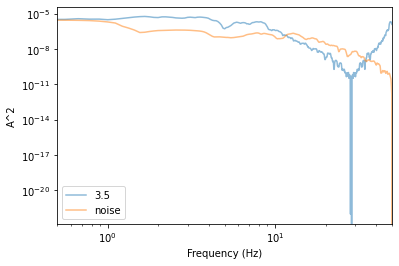

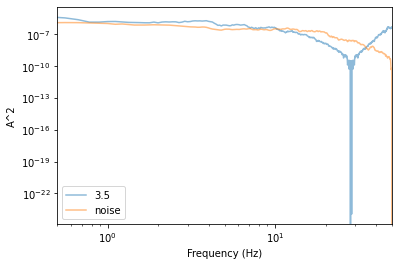

/tmp/ipykernel_1086248/1552908318.py:108: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  axs.set_yscale('log')


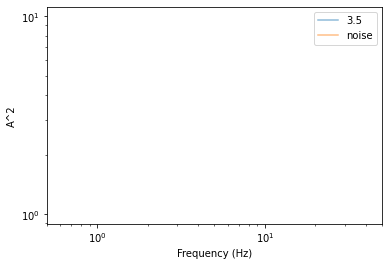

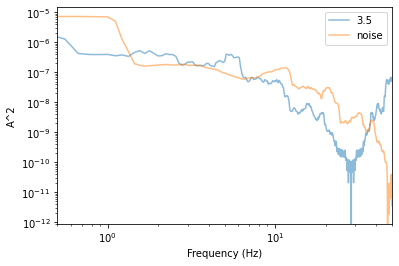

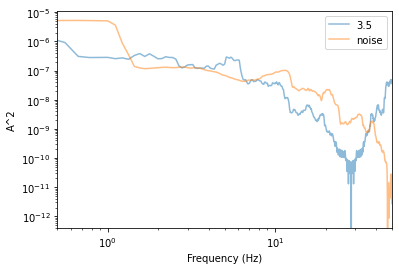

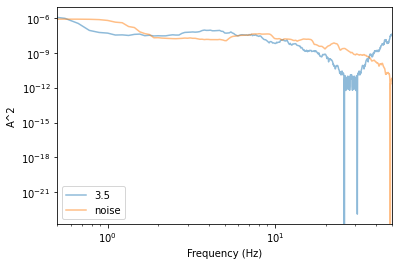

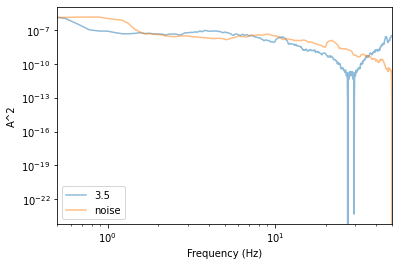

...

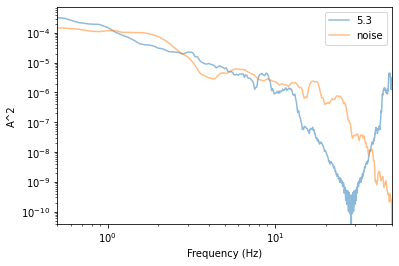

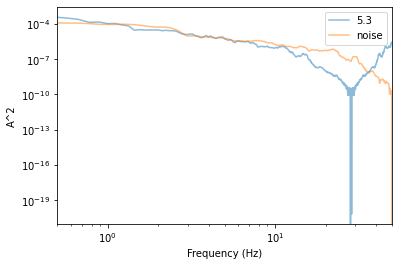

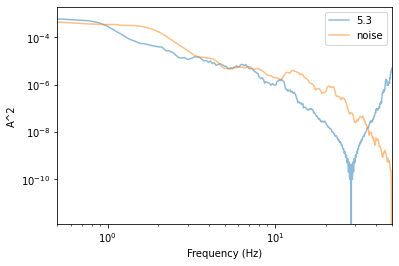

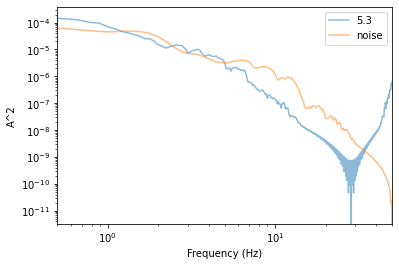

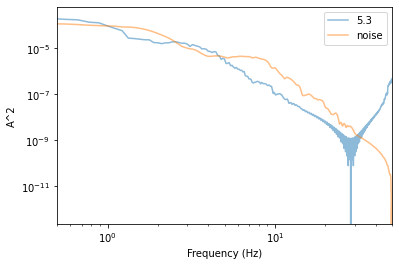

/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc/lib/python3.10/site-packages/obspy/io/stationxml/core.py:91: UserWarning: The StationXML file has version 1, ObsPy can read versions (1.0, 1.1). Proceed with caution.
  warnings.warn("The StationXML file has version %s, ObsPy can "
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc/lib/python3.10/site-packages/obspy/io/stationxml/core.py:91: UserWarning: The StationXML file has version 1, ObsPy can read versions (1.0, 1.1). Proceed with caution.
  warnings.warn("The StationXML file has version %s, ObsPy can "


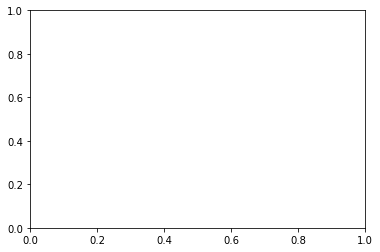

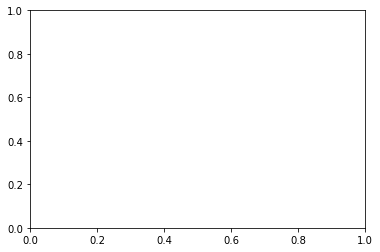

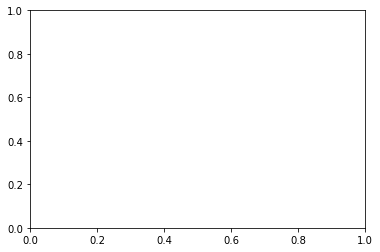

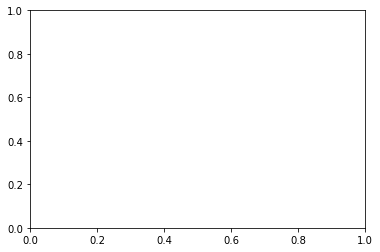

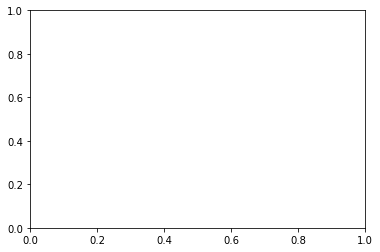

...

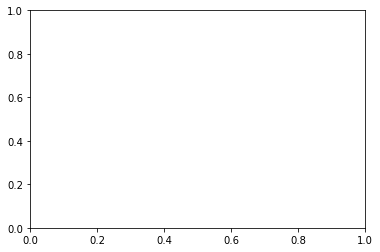

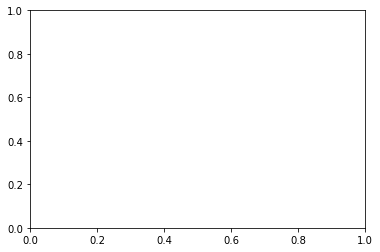

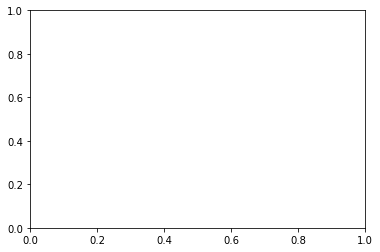

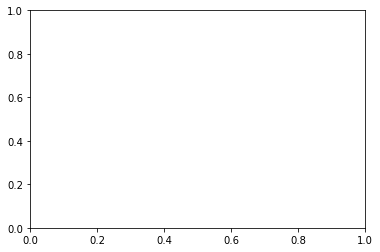

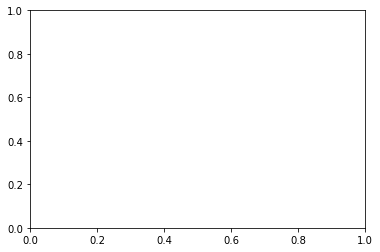

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


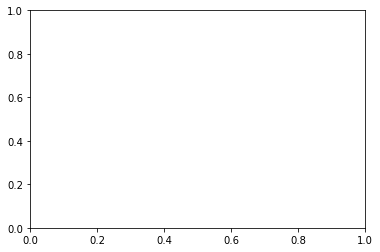

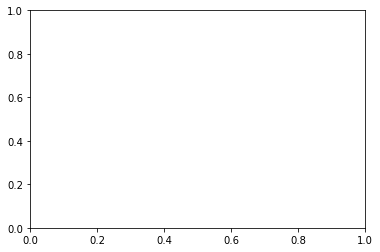

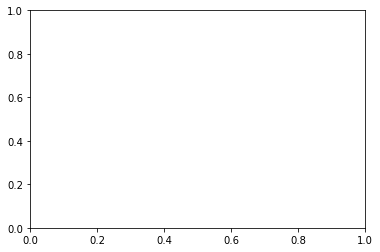

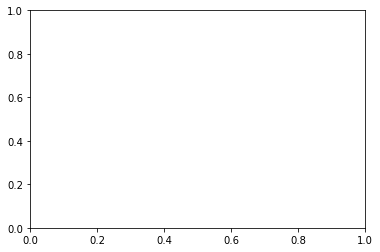

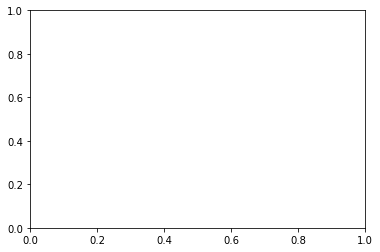

...

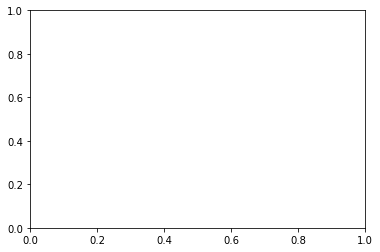

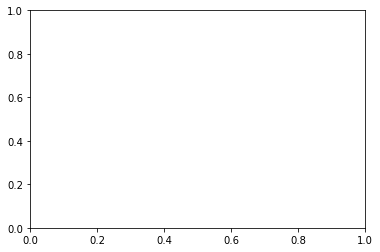

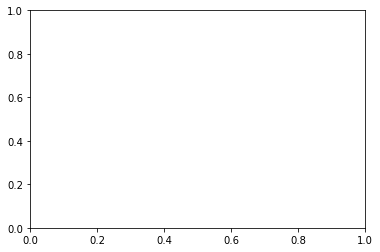

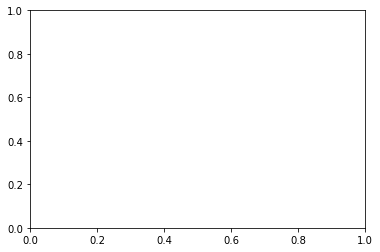

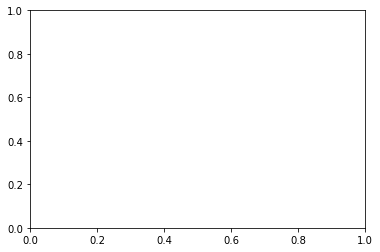

/tmp/ipykernel_1086248/1552908318.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1,1)
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc/lib/python3.10/site-packages/obspy/io/mseed/headers.py:823: InternalMSEEDWarning: CZ_MORC__HHE_D: Warning: Number of blockettes in fixed header (1) does not match the number parsed (2)
  warnings.warn(_w, InternalMSEEDWarning)
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc/lib/python3.10/site-packages/obspy/io/mseed/headers.py:823: InternalMSEEDWarning: CZ_MORC__HHN_D: Warning: Number of blockettes in fixed header (1) does not match the number parsed (2)
  warnings.warn(_w, InternalMSEEDWarning)
/home/earthquakes1/software/Ubuntu/anaconda3/envs/rlc/lib/python3.10/site-packages/obspy/io/mseed

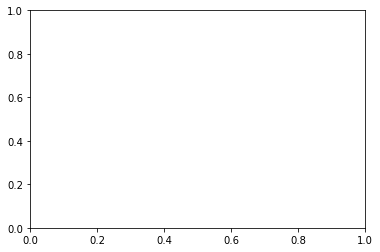

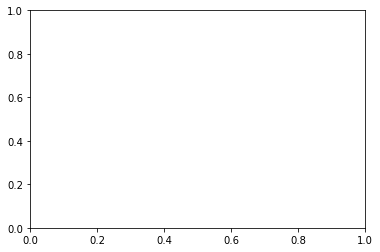

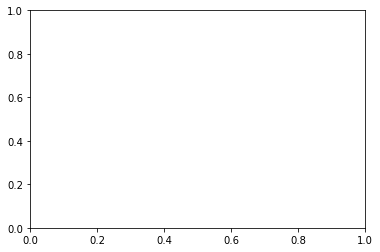

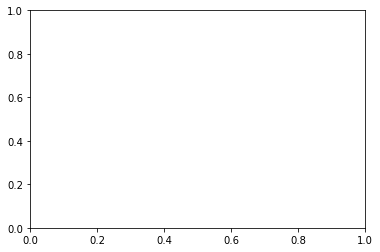

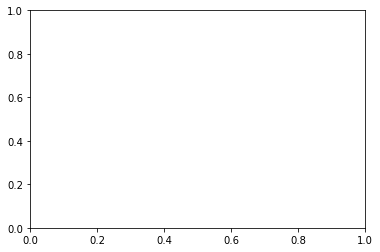

...

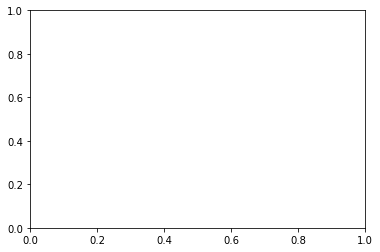

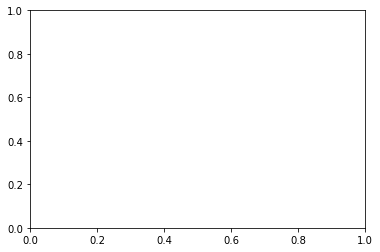

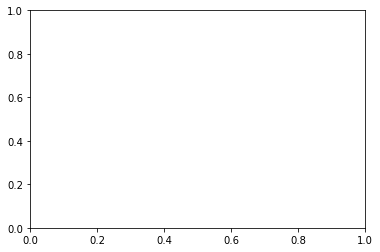

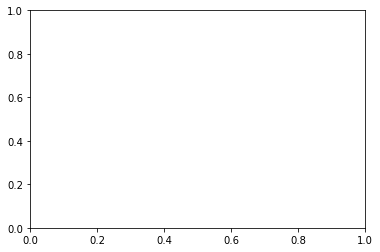

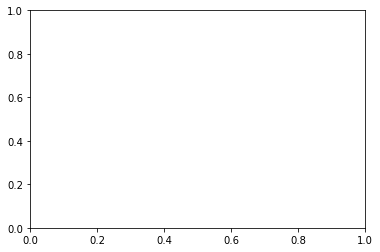

 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.
 WARNING (norm_resp): computed and reported sensitivities differ by more than 5 percent. 
	 Execution continuing.


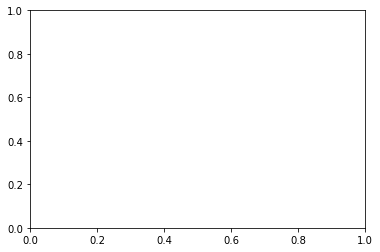

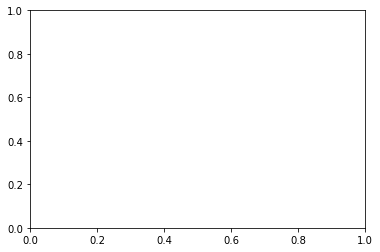

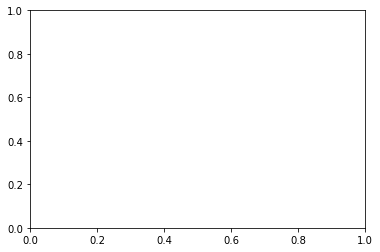

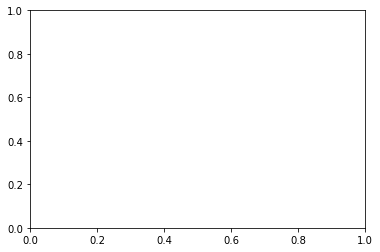

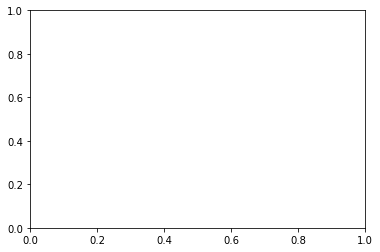

In [44]:
cmap = ['tab:blue','tab:orange','tab:green','tab:red','tab:purple','tab:brown','tab:pink','tab:gray','tab:olive','tab:cyan']

failed = []
for eq_no in range(0, len(eq_with_data[0:100])):

    eq_name = eq_with_data[eq_no]
    try:
        data = obspy.read(root+eq_name+'/data/*/*')
        #data.plot()
        inv = obspy.read_inventory(root+eq_name+'/station_xml_files/*')
        data.remove_response(inv)
        with open(root+eq_name+'/picks.pkl', 'rb') as f:
            picks = pickle.load(f)
    except: 
        break
    if len(data)>0:
        successful = 0
        for tr_no in range(0, len(data)):
            fig, axs = plt.subplots(1,1)
            try:
                sr = data[tr_no].stats.sampling_rate
                tr_name = data[tr_no].stats.network+'.'+data[tr_no].stats.station+'.'+data[tr_no].stats.location
                #print(tr_name)
                pick = UTCDateTime(picks[tr_name])
                start = pick #int((pick - data[tr_no].stats.starttime)*sr)
                end = pick + 4 # int(start + 4 * sr)
                d = data[tr_no].copy()#.filter('lowpass', freq=10)
                #d.lowpass(20)
                d.interpolate(100, 'lanczos', a = 20)
                d.filter('highpass', freq=0.1) #anything less than 0.25s (1/4s) we can't undertand or model, could be aliased.
                d.detrend()
                d.integrate() #displacement spectra
                d.detrend()
                signal = d.copy()
                signal = signal.trim(start, end)
                signal.detrend()
                #plt.plot(coda)
                #plt.show()

                dt = d.stats.delta

                #creating the frequencies to plot on x axis 
                Pfreq  = scipy.fft.rfftfreq(len(signal),dt)
                #doing the multitaper to get the spectra 
                N = len(signal)
                NW=0.01*N
                k=25
                [tapers, eigen] = dpss(N, NW, k)
                for eigen_no in range(0, len(eigen)):
                    if eigen[eigen_no] <= 0.5:
                        k = eigen_no
                        break
                [tapers, eigen] = dpss(N, NW, k)
                #print(eigen)
                freq_complex, weights, eigenvalues=pmtm(signal, e=eigen, v=tapers, show=False)
                freq = abs(freq_complex)
                freq_signal = np.mean(freq,axis =0)
                freq_sdv_signal = np.std(freq,axis =0)

                noise = d.copy()
                noise = noise.trim(start-timedelta(seconds = 7), end-timedelta(seconds = 2))
                noise.detrend()
                #plt.plot(coda)
                #plt.show()

                dt = d.stats.delta

                #creating the frequencies to plot on x axis 
                Pfreq  = scipy.fft.rfftfreq(len(noise),dt)
                #doing the multitaper to get the spectra 
                N = len(noise)
                NW=0.01*N
                k=25
                [tapers, eigen] = dpss(N, NW, k)
                for eigen_no in range(0, len(eigen)):
                    if eigen[eigen_no] <= 0.5:
                        k = eigen_no
                        break
                [tapers, eigen] = dpss(N, NW, k)
                #print(eigen)
                freq_complex, weights, eigenvalues=pmtm(noise, e=eigen, v=tapers, show=False)
                freq = abs(freq_complex)
                freq_noise = np.mean(freq,axis =0)
                freq_sdv_noise = np.std(freq,axis =0)

                dist = util.calc_hypo_dist(cat_with_data[eq_no], d, inv)
                mag = cat_with_data[eq_no].magnitudes[0].mag
                binned_spectra[int(np.round(mag, 0))][int(dist//50)].append([Pfreq[:-1],freq[0:N//2]])

                #plotting the spectra in loglog
                #print('plot')
                #if successful == 0:
                axs.plot(Pfreq[:-1],freq_signal[0:N//2]-min(freq_signal[0:N//2]), alpha = 0.5, label=str(cat_with_data[eq_no].magnitudes[0].mag))#, color = cmap[eq_no])#tr_name + data[tr_no].stats.channel)
                axs.plot(Pfreq[:-1],freq_noise[0:N//2]-min(freq_noise[0:N//2]), alpha = 0.5, label='noise')#, color = cmap[eq_no])#tr_name + data[tr_no].stats.channel)
                #plt.fill_between(Pfreq[:-1],(Sk+Sk_sdv)[0:N//2],(Sk-Sk_sdv)[0:N//2],alpha=0.2)
                axs.set_xlabel('Frequency (Hz)');
                axs.set_ylabel('A^2');
                #plt.title(tr_name + data[tr_no].stats.channel+' coda wave Power spectra');
                #else:
                    #axs.plot(Pfreq[:-1],freq[0:N//2]-min(freq[0:N//2]), color = cmap[eq_no], alpha = 0.5)#tr_name + data[tr_no].stats.channel)

                #successful += 1

                #print(freq_MHZ.shape)
                #plt.show()

                axs.legend();
                #axs.set_title('M'+str(cat_with_data[eq_no].magnitudes[0].mag) + ' ' + eq_name)
                axs.set_yscale('log')
                axs.set_xscale('log')
                axs.set_xlim(0.5, 50)
                plt.savefig('/home/earthquakes1/homes/Rebecca/phd/seismo_det/figures/spectra/signal_vs_noise/'+str(eq_no)+'_'+str(tr_no))
                plt.show()
            except:
                failed.append([eq_name, tr_name])
#plt.close()


In [19]:
freq

array([[7.29728402e-06, 6.08237750e-06, 3.55961057e-06, ...,
        1.76394098e-06, 3.55961057e-06, 6.08237750e-06],
       [7.07845567e-07, 4.62257885e-06, 5.08870542e-06, ...,
        2.51109437e-06, 5.08870542e-06, 4.62257885e-06],
       [2.93800150e-06, 5.30755939e-07, 4.98704978e-06, ...,
        5.39274097e-06, 4.98704978e-06, 5.30755939e-07],
       ...,
       [3.38158989e-06, 6.12886699e-07, 2.99214821e-06, ...,
        1.30466757e-06, 2.99214821e-06, 6.12886699e-07],
       [4.90166818e-07, 1.83930320e-06, 6.23146185e-07, ...,
        1.11504078e-06, 6.23146185e-07, 1.83930320e-06],
       [1.38134143e-06, 9.20473693e-07, 8.59544746e-07, ...,
        3.92742930e-07, 8.59544746e-07, 9.20473693e-07]])

In [10]:
import random
(a, b) = np.array(binned_spectra).shape
fig, axs = plt.subplots(4, b, figsize=(12.8,9.6))
for mag_no in range(len(binned_spectra)):
    for dist_no in range(len(binned_spectra[mag_no])):
        for item in binned_spectra[mag_no][dist_no]:
            axs[mag_no-3][dist_no].plot(item[0], item[1], color = 'midnightblue', alpha = random.randrange(10,70,1)/100, linewidth = 0.5)
            axs[mag_no-3][dist_no].set_yscale('log')
            axs[mag_no-3][dist_no].set_xscale('log')
        if len(binned_spectra[mag_no][dist_no])>0:
            axs[mag_no-3][dist_no].plot(np.median(binned_spectra[mag_no][dist_no],0)[0], np.median(binned_spectra[mag_no][dist_no],0)[1], color='red')
axs[3][0].set_xticks([])
axs[3][2].set_xticks([])
axs[3][3].set_xticks([])
axs[3][0].set_yticks([])
axs[3][2].set_yticks([])
axs[3][3].set_yticks([])
#ax.set_yticks([])
axs[0][0].set_ylabel('M2.5--3.5', rotation=0, labelpad=30, fontsize = 12)
axs[1][0].set_ylabel('M3.5--4.5', rotation=0, labelpad=30, fontsize = 12)
axs[2][0].set_ylabel('M4.5--5.5', rotation=0, labelpad=30, fontsize = 12)
axs[3][0].set_ylabel('M5.5--6.5', rotation=0, labelpad=55, fontsize = 12)
axs[0][0].set_title('0--50 km')
axs[0][1].set_title('50--100 km')
axs[0][2].set_title('100--150 km')
axs[0][3].set_title('150--200 km')
fig.add_subplot(111, frame_on=False)
plt.tick_params(labelcolor="none", bottom=False, left=False)
plt.title('Frequency spectra for 100 earthquakes binned in magnitude and station distance \n red = median in bin', fontsize = 16, pad = 20)
plt.xlabel("log(f)", fontsize = 14)#, labelpad=50)
plt.ylabel("log(A)", fontsize = 14, labelpad=50)
fig.tight_layout()
#plt.savefig('/home/earthquakes1/homes/Rebecca/phd/seismo_det/figures/spectra/3000_eq_with_ave')


/tmp/ipykernel_1086248/3825027625.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  (a, b) = np.array(binned_spectra).shape


all medians on one plot

In [46]:
from scipy.interpolate import interp1d
m = interp1d([0,615],[0.3,1])

TypeError: float() argument must be a string or a number, not 'interp1d'

In [55]:
import random
colors = ['','','','#003f5c','#7a5195', '#ef5675', '#ffa600']
ls = [':','-.','-','--']
(a, b) = np.array(binned_spectra).shape
fig, axs = plt.subplots(1, 1, figsize=(12.8,9.6))
for mag_no in range(len(binned_spectra)):
    for dist_no in range(len(binned_spectra[mag_no])):
        if len(binned_spectra[mag_no][dist_no])>0:
            print(len(binned_spectra[mag_no][dist_no]))
            axs.plot(np.median(binned_spectra[mag_no][dist_no],0)[0], np.median(binned_spectra[mag_no][dist_no],0)[1], color = colors[mag_no], label = '~M'+str(mag_no)+'/'+str(dist_no*25)+'-'+str((dist_no+1)*25)+'km', linestyle = ls[dist_no], alpha = float(m(len(binned_spectra[mag_no][dist_no]))))
axs.set_yscale('log')
axs.set_xscale('log')
    

fig.add_subplot(111, frame_on=False)
plt.tick_params(labelcolor="none", bottom=False, left=False)
plt.title('median frequency spectra binned in magnitude and station distance', fontsize = 16, pad = 20)
plt.xlabel("log(f)", fontsize = 14)#, labelpad=50)
plt.ylabel("log(A)", fontsize = 14, labelpad=50)
fig.tight_layout()
fig.legend()
#plt.savefig('/home/earthquakes1/homes/Rebecca/phd/seismo_det/figures/spectra/3000_eq')


/tmp/ipykernel_690068/795391549.py:4: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  (a, b) = np.array(binned_spectra).shape


278
615
282
144
179
440
290
84
9
57
15
6
3


In [ ]:
inv

In [ ]:
axs.set_xlim(0.01, 52)
axs.set_ylim(0.00000001, 10)
plt.show()
fig

In [ ]:
np.median(binned_spectra[mag_no][dist_no],0)[1]

In [51]:
fig, axs = plt.subplots(2,1, sharex=True, figsize = (12,8))
for mag_no in range(len(binned_spectra)):
    for dist_no in range(len(binned_spectra[mag_no])):
        if len(binned_spectra[mag_no][dist_no])>0:
            axs[0].plot(np.array(np.median(binned_spectra[mag_no][dist_no],0)[0]), np.array(np.gradient(np.log(np.median(binned_spectra[mag_no][dist_no],0)[1]))))
            item = binned_spectra[mag_no][dist_no][0]
            axs[1].plot(np.median(binned_spectra[mag_no][dist_no],0)[0], np.median(binned_spectra[mag_no][dist_no],0)[1], label = '~M'+str(mag_no)+'/'+str(dist_no*25)+'-'+str((dist_no+1)*25)+'km')
            #axs[1].plot(item[0], item[1], color = 'midnightblue')
            axs[0].set_xscale('log')
            #axs[0].yscale('log')
            axs[0].set_xlim([0.5, 50])
            axs[1].set_xlim([0.5, 50])
            axs[1].set_xscale('log')
            axs[1].set_yscale('log')
            axs[0].set_ylabel('diff log(a)')
            axs[1].set_ylabel('log(a)')
            axs[1].set_xlabel('log(f)')
            axs[1].legend()

In [52]:
fig, axs = plt.subplots(2,1, sharex=True, figsize = (12,8))
for mag_no in range(len(binned_spectra)):
    for dist_no in range(len(binned_spectra[mag_no])):
        if len(binned_spectra[mag_no][dist_no])>0:
            axs[0].plot(np.array(np.median(binned_spectra[mag_no][dist_no],0)[0]), np.array(np.gradient(np.log(np.median(np.array(binned_spectra[mag_no][dist_no])**2,0)[1]))))
            item = binned_spectra[mag_no][dist_no][0]
            axs[1].plot(np.median(binned_spectra[mag_no][dist_no],0)[0], np.median(np.array(binned_spectra[mag_no][dist_no])**2,0)[1], label = '~M'+str(mag_no)+'/'+str(dist_no*25)+'-'+str((dist_no+1)*25)+'km')
            #axs[1].plot(item[0], item[1], color = 'midnightblue')
            axs[0].set_xscale('log')
            #axs[0].yscale('log')
            axs[0].set_xlim([0.5, 50])
            axs[1].set_xlim([0.5, 50])
            axs[1].set_xscale('log')
            axs[1].set_yscale('log')
            axs[0].set_ylabel('diff log(power)')
            axs[1].set_ylabel('log(power)')
            axs[1].set_xlabel('log(f)')
            axs[1].legend()

In [23]:
np.log(np.array(np.median(binned_spectra[3][0],0)))[1]

/tmp/ipykernel_690068/746857814.py:1: RuntimeWarning: divide by zero encountered in log
  np.log(np.array(np.median(binned_spectra[3][0],0)))[1]


array([-12.93991832, -12.86705467, -12.88730989, -12.87724941,
       -12.96078987, -13.10764567, -13.43933691, -13.59764426,
       -13.69484295, -13.79109736, -13.83797386, -13.908152  ,
       -13.97993984, -13.99993692, -14.01804069, -14.05126637,
       -14.14914429, -14.20863823, -14.26305791, -14.28028408,
       -14.32434305, -14.34774558, -14.38645979, -14.46805832,
       -14.52835214, -14.47420375, -14.51169956, -14.5492534 ,
       -14.59132433, -14.6888377 , -14.68451671, -14.72716993,
       -14.8295945 , -14.97949175, -14.95316982, -15.05663129,
       -15.07656266, -15.17607363, -15.25159453, -15.2796353 ,
       -15.32580121, -15.3430482 , -15.40900379, -15.45463141,
       -15.48398483, -15.56364571, -15.57721334, -15.58803037,
       -15.6222729 , -15.64172176, -15.69610993, -15.69311716,
       -15.74591501, -15.77829302, -15.82850678, -15.88684692,
       -15.89943155, -15.94392284, -16.03240331, -16.02728672,
       -16.09265287, -16.09998565, -16.15816056, -16.22

In [ ]:
binned_spectra[3][0][0]

In [24]:
np.array(np.gradient(np.log(np.median(binned_spectra[3][0],0)[1])))

array([ 0.07286365,  0.02630422, -0.00509737, -0.03673999, -0.11519813,
       -0.23927352, -0.2449993 , -0.12775302, -0.09672655, -0.07156545,
       -0.05852732, -0.07098299, -0.04589246, -0.01905042, -0.02566472,
       -0.0655518 , -0.07868593, -0.05695681, -0.03582292, -0.03064257,
       -0.03373075, -0.03105837, -0.06015637, -0.07094617, -0.00307271,
        0.00832629, -0.03752482, -0.03981239, -0.06979215, -0.04659619,
       -0.01916611, -0.07253889, -0.12616091, -0.06178766, -0.03856977,
       -0.06169642, -0.05972117, -0.08751593, -0.05178084, -0.03710334,
       -0.03170645, -0.04160129, -0.05579161, -0.03749052, -0.05450715,
       -0.04661425, -0.01219233, -0.02252978, -0.02684569, -0.03691852,
       -0.0256977 , -0.02490254, -0.04258793, -0.04129588, -0.05427695,
       -0.03546238, -0.02853796, -0.06648588, -0.04168194, -0.03012478,
       -0.03634946, -0.03275384, -0.06113038, -0.07369688, -0.06086768,
       -0.01691053, -0.05295628, -0.09784768, -0.06811868, -0.03